# Part 1:  Choropleth Maps 

In [1]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]


{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

In [2]:
len(counties["features"])

3221

In [3]:
import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})
df.head()

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5


In [4]:
df.shape

(3219, 2)

In [5]:
df.dtypes

fips      object
unemp    float64
dtype: object

In [6]:
df.describe()

,unemp
count,3219.000000
mean,5.465642
std,2.344429
min,1.700000
25%,4.000000
50%,5.000000
75%,6.300000
max,23.500000


In [7]:
df.describe(include='object')

,fips
count,3219
unique,3219
top,01001
freq,1


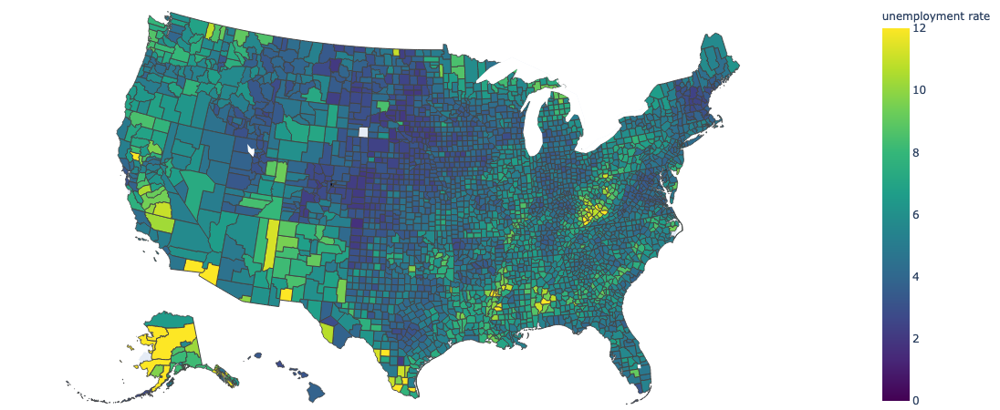

In [8]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [9]:
import plotly.express as px

df = px.data.election()
geojson = px.data.election_geojson()

print(df["district"][2])
print(geojson["features"][0]["properties"])

11-Sault-au-Récollet
{'district': '11-Sault-au-Récollet'}


In [10]:
df.head()

,district,Coderre,Bergeron,Joly,total,winner,result,district_id
0,101-Bois-de-Liesse,2481,1829,3024,7334,Joly,plurality,101
1,102-Cap-Saint-Jacques,2525,1163,2675,6363,Joly,plurality,102
2,11-Sault-au-Récollet,3348,2770,2532,8650,Coderre,plurality,11
3,111-Mile-End,1734,4782,2514,9030,Bergeron,majority,111
4,112-DeLorimier,1770,5933,3044,10747,Bergeron,majority,112


In [11]:
df.shape

(58, 8)

In [12]:
df.dtypes

district       object
Coderre         int64
Bergeron        int64
Joly            int64
total           int64
winner         object
result         object
district_id     int64
dtype: object

In [13]:
geojson["features"][0]

{'type': 'Feature',
 'geometry': {'type': 'MultiPolygon',
  'coordinates': [[[[-73.6363215300962, 45.5759177646435],
     [-73.6362833815582, 45.5758266113331],
     [-73.6446417578686, 45.5658132919643],
     [-73.6453511352974, 45.5647725775888],
     [-73.648867564748, 45.5586898267402],
     [-73.6513170845065, 45.5545659435652],
     [-73.6515658357324, 45.5554439857955],
     [-73.6660837831645, 45.5596724837829],
     [-73.6706609041685, 45.5610978251999],
     [-73.6676019919116, 45.5632340862888],
     [-73.6645385824068, 45.5642716484367],
     [-73.663663123697, 45.5654269638586],
     [-73.663336397858, 45.5666288247853],
     [-73.6637764768649, 45.5678900619231],
     [-73.6625073244826, 45.5688479494114],
     [-73.6624620526633, 45.5708304456346],
     [-73.6620201425015, 45.5713925326191],
     [-73.6616100197742, 45.5737924780218],
     [-73.6612199500215, 45.5747171555678],
     [-73.6625087613399, 45.5748980132699],
     [-73.6639172423219, 45.5730041908097],
     [

In [14]:
len(geojson["features"])

58

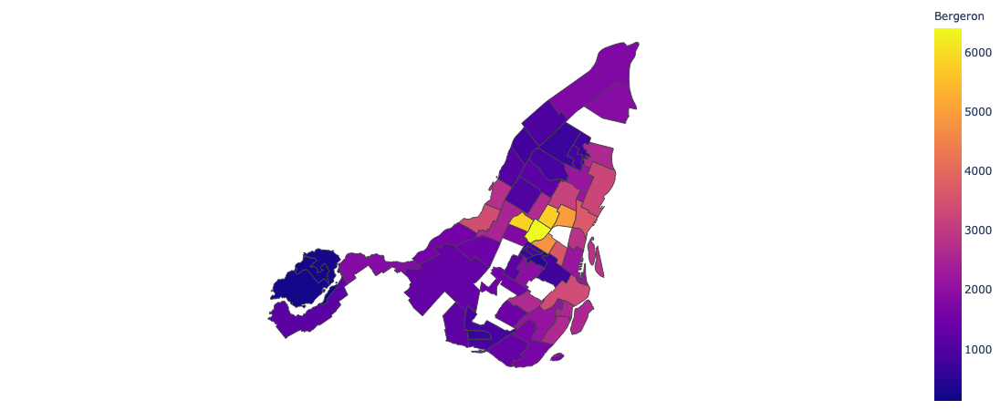

In [15]:
import plotly.express as px

df = px.data.election()
geojson = px.data.election_geojson()

fig = px.choropleth(df, geojson=geojson, color="Bergeron",
                    locations="district", featureidkey="properties.district",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

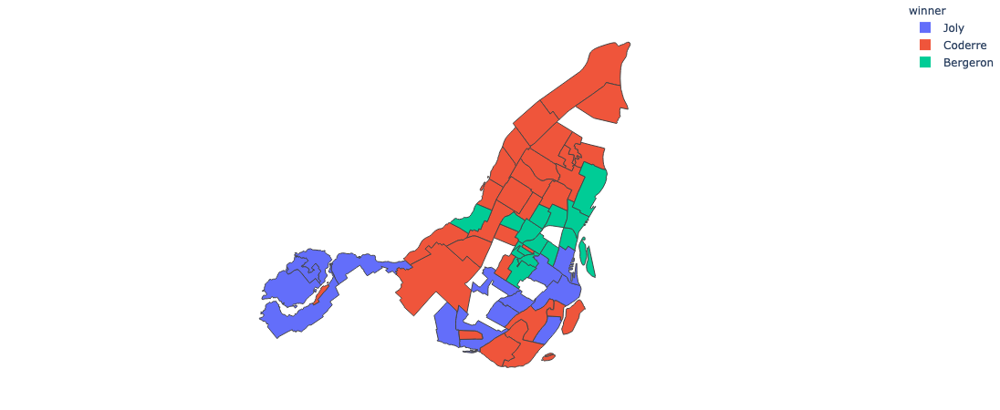

In [16]:
import plotly.express as px

df = px.data.election()
geojson = px.data.election_geojson()

fig = px.choropleth(df, geojson=geojson, color="winner",
                    locations="district", featureidkey="properties.district",
                    projection="mercator", hover_data=["Bergeron", "Coderre", "Joly"]
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

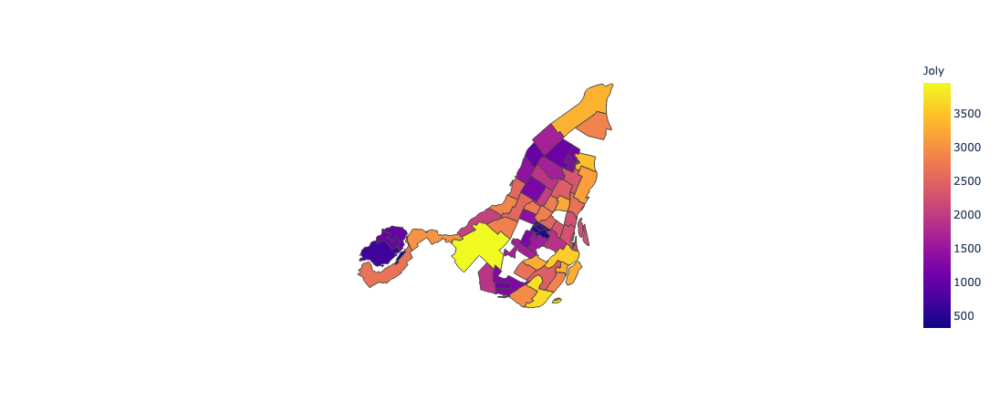

In [17]:
import plotly.express as px
import geopandas as gpd

df = px.data.election()
geo_df = gpd.GeoDataFrame.from_features(
    px.data.election_geojson()["features"]
).merge(df, on="district").set_index("district")

fig = px.choropleth(geo_df,
                   geojson=geo_df.geometry,
                   locations=geo_df.index,
                   color="Joly",
                   projection="mercator")
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [18]:
geo_df.head()

,geometry,Coderre,Bergeron,Joly,total,winner,result,district_id
district,,,,,,,,
11-Sault-au-Récollet,"MULTIPOLYGON (((-73.63632 45.57592, -73.63628 ...",3348,2770,2532,8650,Coderre,plurality,11
12-Saint-Sulpice,"POLYGON ((-73.62175 45.55448, -73.62350 45.553...",3252,2521,2543,8316,Coderre,plurality,12
13-Ahuntsic,"POLYGON ((-73.65132 45.55457, -73.65687 45.545...",2979,3430,2873,9282,Bergeron,plurality,13
14-Bordeaux-Cartierville,"POLYGON ((-73.70430 45.54419, -73.70421 45.543...",3612,1554,2081,7247,Coderre,plurality,14
21-Ouest,"POLYGON ((-73.55769 45.59322, -73.56942 45.597...",2184,691,1076,3951,Coderre,majority,21


In [19]:
geo_df.shape

(57, 8)

In [20]:
geo_df.dtypes

geometry       geometry
Coderre           int64
Bergeron          int64
Joly              int64
total             int64
winner           object
result           object
district_id       int64
dtype: object

In [21]:
geo_df.describe()

,Coderre,Bergeron,Joly,total,district_id
count,57.000000,57.000000,57.000000,57.000000,57.000000
mean,2591.175439,1977.263158,2105.578947,6674.017544,96.035088
std,1512.403458,1466.310013,950.104918,2896.213103,56.968025
min,332.000000,131.000000,326.000000,789.000000,11.000000
25%,1546.000000,851.000000,1266.000000,4438.000000,43.000000
50%,2432.000000,1554.000000,2282.000000,7370.000000,92.000000
75%,3536.000000,2653.000000,2822.000000,9111.000000,141.000000
max,6591.000000,6408.000000,3959.000000,11050.000000,194.000000


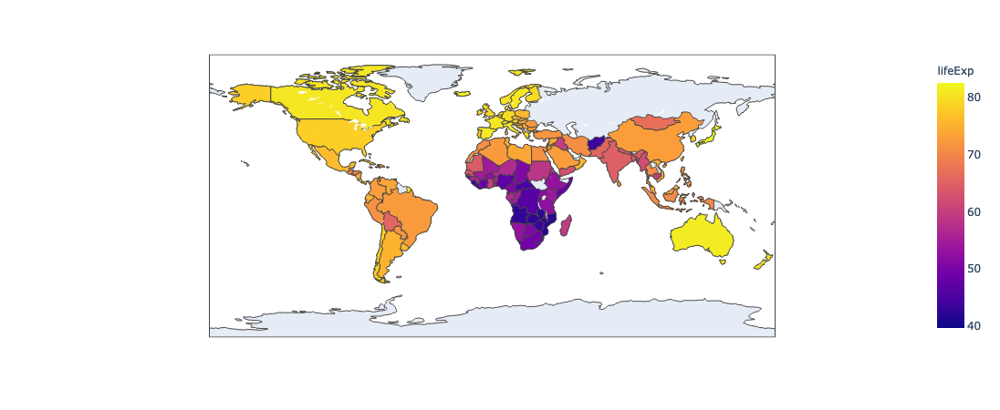

In [22]:
import plotly.express as px

df = px.data.gapminder().query("year==2007")
fig = px.choropleth(df, locations="iso_alpha",
                    color="lifeExp", # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.show()


In [23]:
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32


In [24]:
df.shape

(142, 8)

In [25]:
df.dtypes

country       object
continent     object
year           int64
lifeExp      float64
pop            int64
gdpPercap    float64
iso_alpha     object
iso_num        int64
dtype: object

In [26]:
df.describe()

,year,lifeExp,pop,gdpPercap,iso_num
count,142.0,142.000000,1.420000e+02,142.000000,142.000000
mean,2007.0,67.007423,4.402122e+07,11680.071820,425.880282
std,0.0,12.073021,1.476214e+08,12859.937337,249.111541
min,2007.0,39.613000,1.995790e+05,277.551859,4.000000
25%,2007.0,57.160250,4.508034e+06,1624.842248,209.500000
50%,2007.0,71.935500,1.051753e+07,6124.371109,410.000000
75%,2007.0,76.413250,3.121004e+07,18008.835640,636.000000
max,2007.0,82.603000,1.318683e+09,49357.190170,894.000000


In [27]:
df.describe(include='object')

,country,continent,iso_alpha
count,142,142,142
unique,142,5,141
top,Afghanistan,Africa,KOR
freq,1,52,2


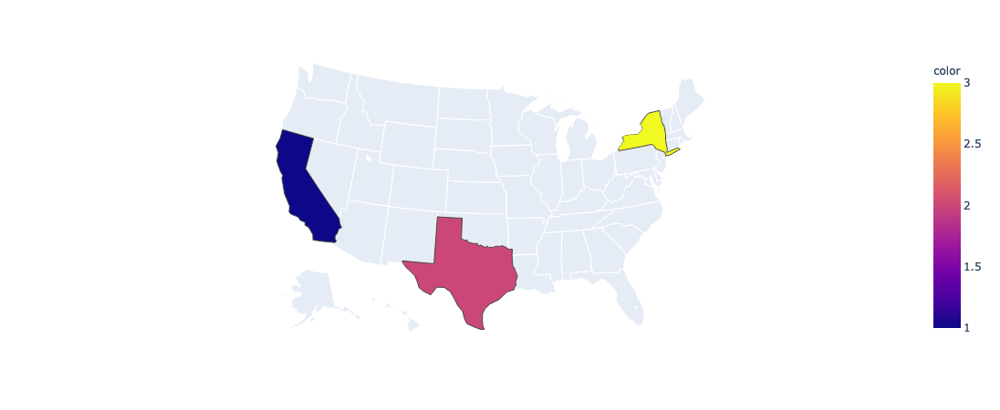

In [28]:
import plotly.express as px

fig = px.choropleth(locations=["CA", "TX", "NY"], locationmode="USA-states", color=[1,2,3], scope="usa")
fig.show()

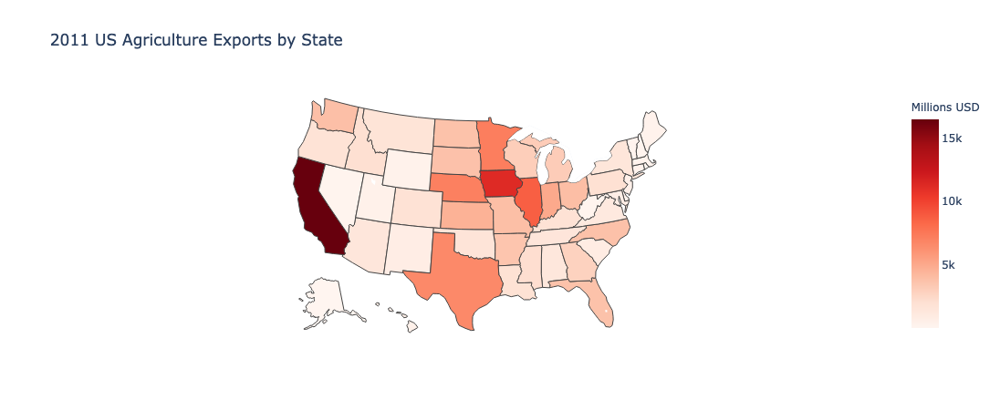

In [29]:
import plotly.graph_objects as go

import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv')

fig = go.Figure(data=go.Choropleth(
    locations=df['code'], # Spatial coordinates
    z = df['total exports'].astype(float), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'Reds',
    colorbar_title = "Millions USD",
))

fig.update_layout(
    title_text = '2011 US Agriculture Exports by State',
    geo_scope='usa', # limite map scope to USA
)

fig.show()

In [30]:
df.head()

,code,state,category,total exports,beef,pork,poultry,dairy,fruits fresh,fruits proc,total fruits,veggies fresh,veggies proc,total veggies,corn,wheat,cotton
0,AL,Alabama,state,1390.63,34.4,10.6,481.0,4.06,8.0,17.1,25.11,5.5,8.9,14.33,34.9,70.0,317.61
1,AK,Alaska,state,13.31,0.2,0.1,0.0,0.19,0.0,0.0,0.00,0.6,1.0,1.56,0.0,0.0,0.00
2,AZ,Arizona,state,1463.17,71.3,17.9,0.0,105.48,19.3,41.0,60.27,147.5,239.4,386.91,7.3,48.7,423.95
3,AR,Arkansas,state,3586.02,53.2,29.4,562.9,3.53,2.2,4.7,6.88,4.4,7.1,11.45,69.5,114.5,665.44
4,CA,California,state,16472.88,228.7,11.1,225.4,929.95,2791.8,5944.6,8736.40,803.2,1303.5,2106.79,34.6,249.3,1064.95


In [31]:
df.shape

(50, 17)

In [32]:
df.dtypes

code              object
state             object
category          object
total exports    float64
beef             float64
pork             float64
poultry          float64
dairy            float64
fruits fresh     float64
fruits proc      float64
total fruits     float64
veggies fresh    float64
veggies proc     float64
total veggies    float64
corn             float64
wheat            float64
cotton           float64
dtype: object

In [33]:
df.describe()

,total exports,beef,pork,poultry,dairy,fruits fresh,fruits proc,total fruits,veggies fresh,veggies proc,total veggies,corn,wheat,cotton
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.00000,50.000000,50.00000,50.000000,50.000000,50.000000,50.000000,50.000000,50.00000
mean,2728.889000,108.394000,122.282000,112.700000,95.725200,90.05000,191.736000,281.79000,44.428000,72.102000,116.523800,273.042000,222.824000,169.32500
std,3144.837608,193.762904,303.492907,162.878644,168.016886,402.16488,856.334256,1258.49891,116.513625,189.088833,305.615222,556.824919,362.291291,402.92782
min,13.310000,0.100000,0.000000,0.000000,0.190000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,465.142500,13.400000,0.525000,2.950000,6.980000,2.12500,4.550000,6.67000,4.325000,6.950000,11.232500,5.875000,8.500000,0.00000
50%,1822.950000,41.050000,16.800000,33.550000,32.165000,4.80000,10.300000,15.11000,12.500000,20.350000,32.910000,37.200000,78.100000,0.00000
75%,3768.665000,106.725000,84.975000,162.425000,101.535000,25.30000,53.925000,79.24000,45.700000,74.175000,119.845000,182.175000,248.725000,102.46500
max,16472.880000,961.000000,1895.600000,630.400000,929.950000,2791.80000,5944.600000,8736.40000,803.200000,1303.500000,2106.790000,2529.800000,1664.500000,2308.76000


In [34]:
df.describe(include='object')

,code,state,category
count,50,50,50
unique,50,50,1
top,AL,Alabama,state
freq,1,1,50


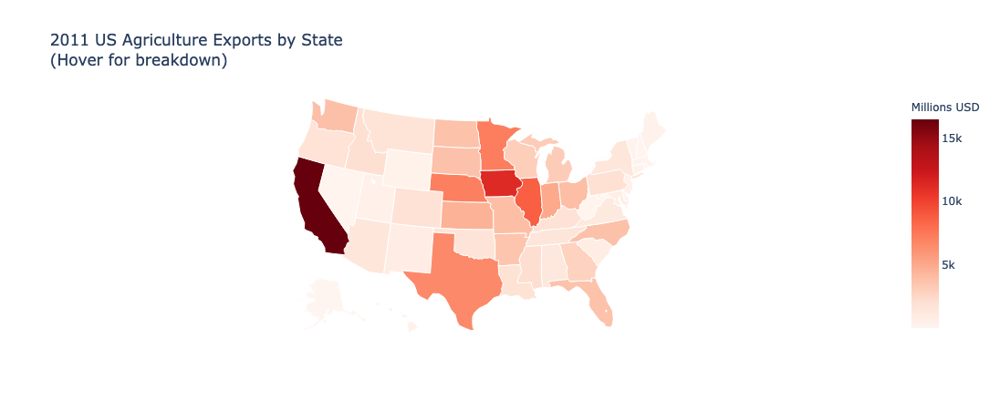

In [35]:
import plotly.graph_objects as go

import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv')

for col in df.columns:
    df[col] = df[col].astype(str)

df['text'] = df['state'] + '<br>' + \
    'Beef ' + df['beef'] + ' Dairy ' + df['dairy'] + '<br>' + \
    'Fruits ' + df['total fruits'] + ' Veggies ' + df['total veggies'] + '<br>' + \
    'Wheat ' + df['wheat'] + ' Corn ' + df['corn']

fig = go.Figure(data=go.Choropleth(
    locations=df['code'],
    z=df['total exports'].astype(float),
    locationmode='USA-states',
    colorscale='Reds',
    autocolorscale=False,
    text=df['text'], # hover text
    marker_line_color='white', # line markers between states
    colorbar_title="Millions USD"
))

fig.update_layout(
    title_text='2011 US Agriculture Exports by State<br>(Hover for breakdown)',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()


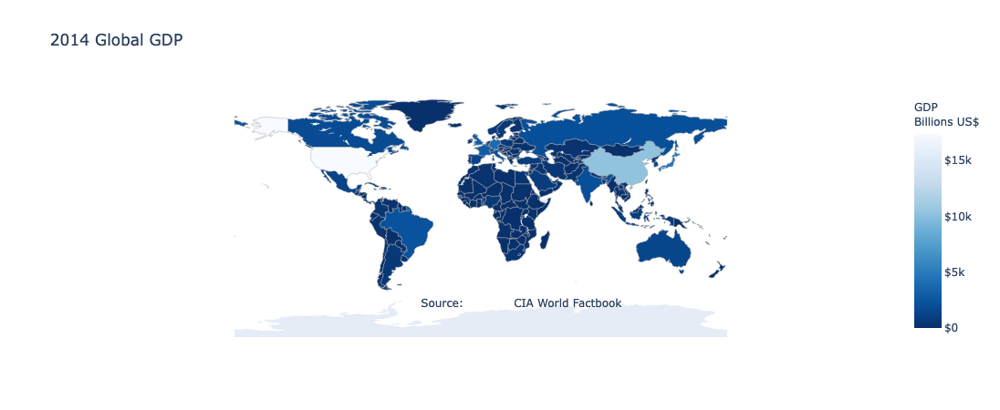

In [36]:
import plotly.graph_objects as go
import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_world_gdp_with_codes.csv')

fig = go.Figure(data=go.Choropleth(
    locations = df['CODE'],
    z = df['GDP (BILLIONS)'],
    text = df['COUNTRY'],
    colorscale = 'Blues',
    autocolorscale=False,
    reversescale=True,
    marker_line_color='darkgray',
    marker_line_width=0.5,
    colorbar_tickprefix = '$',
    colorbar_title = 'GDP<br>Billions US$',
))

fig.update_layout(
    title_text='2014 Global GDP',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
    annotations = [dict(
        x=0.55,
        y=0.1,
        xref='paper',
        yref='paper',
        text='Source: <a href="https://www.cia.gov/library/publications/the-world-factbook/fields/2195.html">\
            CIA World Factbook</a>',
        showarrow = False
    )]
)

fig.show()

In [37]:
df.head()

,COUNTRY,GDP (BILLIONS),CODE
0,Afghanistan,21.71,AFG
1,Albania,13.40,ALB
2,Algeria,227.80,DZA
3,American Samoa,0.75,ASM
4,Andorra,4.80,AND


In [38]:
df.shape

(222, 3)

In [39]:
df.dtypes

COUNTRY            object
GDP (BILLIONS)    float64
CODE               object
dtype: object

In [40]:
df.describe()

,GDP (BILLIONS)
count,222.000000
mean,352.637162
std,1464.855533
min,0.010000
25%,4.615000
50%,21.525000
75%,196.200000
max,17420.000000


In [41]:
df.describe(include='object')

,COUNTRY,CODE
count,222,222
unique,222,221
top,Afghanistan,VGB
freq,1,2


# Part 2:  Bubble Maps 

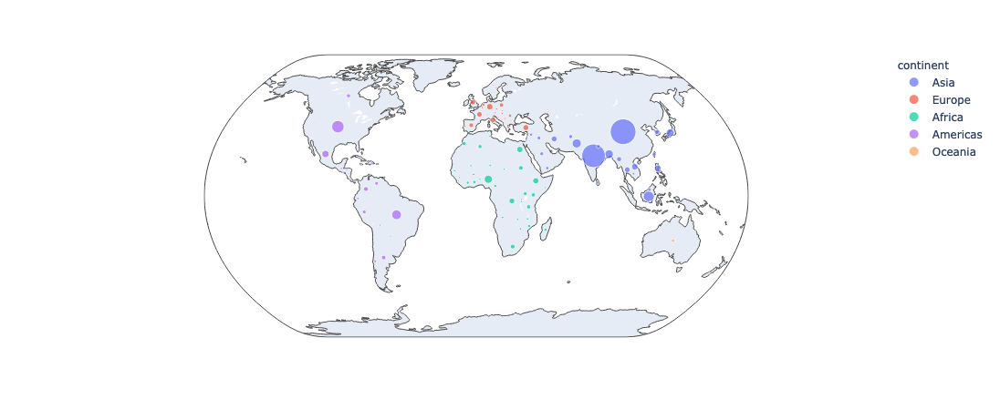

In [42]:
import plotly.express as px
df = px.data.gapminder().query("year==2007")
fig = px.scatter_geo(df, locations="iso_alpha", color="continent",
                     hover_name="country", size="pop",
                     projection="natural earth")
fig.show()

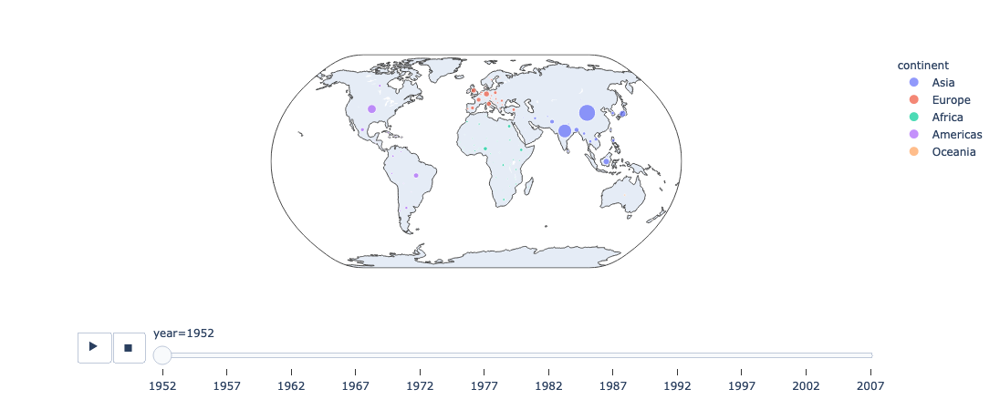

In [43]:
import plotly.express as px
df = px.data.gapminder()
fig = px.scatter_geo(df, locations="iso_alpha", color="continent",
                     hover_name="country", size="pop",
                     animation_frame="year",
                     projection="natural earth")
fig.show()

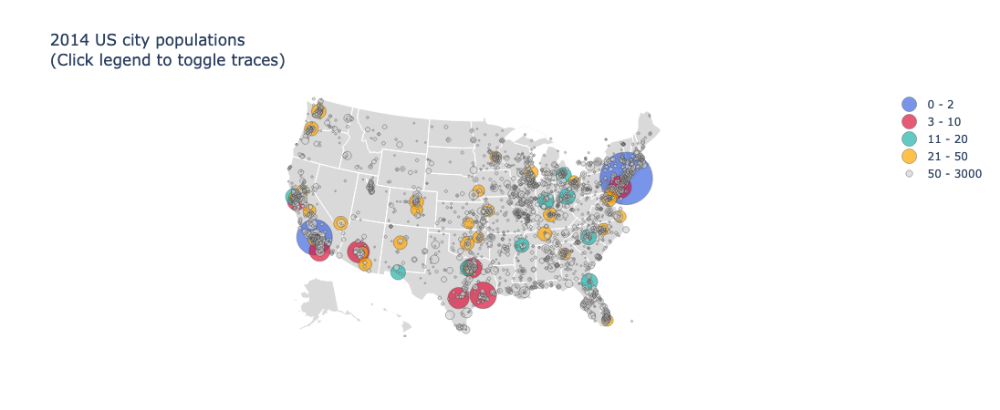

In [44]:
import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_us_cities.csv')
df.head()

df['text'] = df['name'] + '<br>Population ' + (df['pop']/1e6).astype(str)+' million'
limits = [(0,2),(3,10),(11,20),(21,50),(50,3000)]
colors = ["royalblue","crimson","lightseagreen","orange","lightgrey"]
cities = []
scale = 5000

fig = go.Figure()

for i in range(len(limits)):
    lim = limits[i]
    df_sub = df[lim[0]:lim[1]]
    fig.add_trace(go.Scattergeo(
        locationmode = 'USA-states',
        lon = df_sub['lon'],
        lat = df_sub['lat'],
        text = df_sub['text'],
        marker = dict(
            size = df_sub['pop']/scale,
            color = colors[i],
            line_color='rgb(40,40,40)',
            line_width=0.5,
            sizemode = 'area'
        ),
        name = '{0} - {1}'.format(lim[0],lim[1])))

fig.update_layout(
        title_text = '2014 US city populations<br>(Click legend to toggle traces)',
        showlegend = True,
        geo = dict(
            scope = 'usa',
            landcolor = 'rgb(217, 217, 217)',
        )
    )

fig.show()

In [45]:
df.head()

,name,pop,lat,lon,text
0,New York,8287238,40.730599,-73.986581,New York <br>Population 8.287238 million
1,Los Angeles,3826423,34.053717,-118.242727,Los Angeles <br>Population 3.826423 million
2,Chicago,2705627,41.875555,-87.624421,Chicago <br>Population 2.705627 million
3,Houston,2129784,29.758938,-95.367697,Houston <br>Population 2.129784 million
4,Philadelphia,1539313,39.952335,-75.163789,Philadelphia <br>Population 1.539313 million


In [46]:
df.shape

(3228, 5)

In [47]:
df.dtypes

name     object
pop       int64
lat     float64
lon     float64
text     object
dtype: object

In [48]:
df.describe()

,pop,lat,lon
count,3.228000e+03,3228.000000,3228.000000
mean,4.887427e+04,38.079047,-92.956938
std,1.939184e+05,4.968243,15.293931
min,7.094000e+03,24.833333,-124.263944
25%,1.106200e+04,34.141478,-99.787016
50%,1.886600e+04,38.777722,-88.934430
75%,4.103000e+04,41.586787,-81.461418
max,8.287238e+06,49.100000,-68.011971


In [49]:
df.describe(include='object')

,name,text
count,3228,3228
unique,2741,3228
top,Clinton,New York <br>Population 8.287238 million
freq,9,1


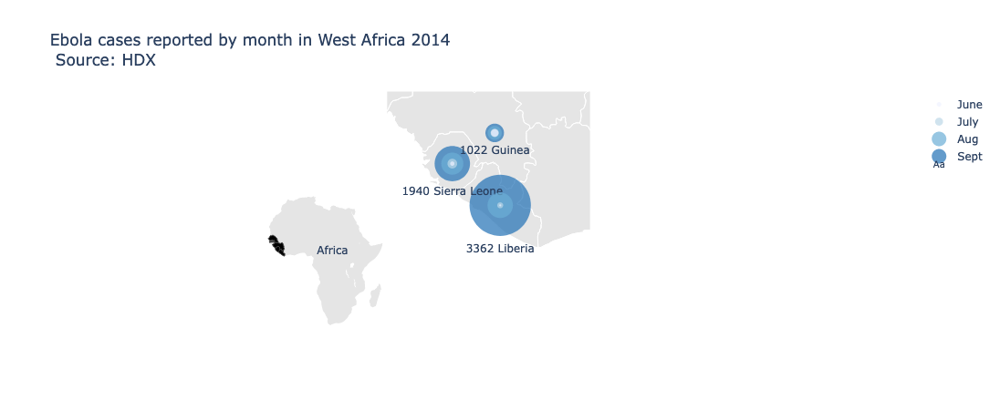

In [50]:
import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_ebola.csv')
df.head()

colors = ['rgb(239,243,255)','rgb(189,215,231)','rgb(107,174,214)','rgb(33,113,181)']
months = {6:'June',7:'July',8:'Aug',9:'Sept'}

fig = go.Figure()

for i in range(6,10)[::-1]:
    df_month = df.query('Month == %d' %i)
    fig.add_trace(go.Scattergeo(
            lon = df_month['Lon'],
            lat = df_month['Lat'],
            text = df_month['Value'],
            name = months[i],
            marker = dict(
                size = df_month['Value']/50,
                color = colors[i-6],
                line_width = 0
            )))

df_sept = df.query('Month == 9')
fig['data'][0].update(mode='markers+text', textposition='bottom center',
                      text=df_sept['Value'].map('{:.0f}'.format).astype(str)+' '+\
                      df_sept['Country'])

# Inset
fig.add_trace(go.Choropleth(
        locationmode = 'country names',
        locations = df_sept['Country'],
        z = df_sept['Value'],
        text = df_sept['Country'],
        colorscale = [[0,'rgb(0, 0, 0)'],[1,'rgb(0, 0, 0)']],
        autocolorscale = False,
        showscale = False,
        geo = 'geo2'
    ))
fig.add_trace(go.Scattergeo(
        lon = [21.0936],
        lat = [7.1881],
        text = ['Africa'],
        mode = 'text',
        showlegend = False,
        geo = 'geo2'
    ))

fig.update_layout(
    title = go.layout.Title(
        text = 'Ebola cases reported by month in West Africa 2014<br> \
Source: <a href="https://data.hdx.rwlabs.org/dataset/rowca-ebola-cases">\
HDX</a>'),
    geo = go.layout.Geo(
        resolution = 50,
        scope = 'africa',
        showframe = False,
        showcoastlines = True,
        landcolor = "rgb(229, 229, 229)",
        countrycolor = "white" ,
        coastlinecolor = "white",
        projection_type = 'mercator',
        lonaxis_range= [ -15.0, -5.0 ],
        lataxis_range= [ 0.0, 12.0 ],
        domain = dict(x = [ 0, 1 ], y = [ 0, 1 ])
    ),
    geo2 = go.layout.Geo(
        scope = 'africa',
        showframe = False,
        landcolor = "rgb(229, 229, 229)",
        showcountries = False,
        domain = dict(x = [ 0, 0.6 ], y = [ 0, 0.6 ]),
        bgcolor = 'rgba(255, 255, 255, 0.0)',
    ),
    legend_traceorder = 'reversed'
)

fig.show()

In [51]:
df.head()

,Country,Month,Year,Lat,Lon,Value
0,Guinea,3,14,9.95,-9.7,122.0
1,Guinea,4,14,9.95,-9.7,224.0
2,Guinea,5,14,9.95,-9.7,291.0
3,Guinea,6,14,9.95,-9.7,413.0
4,Guinea,7,14,9.95,-9.7,460.0


In [52]:
df.shape

(31, 6)

In [53]:
df.dtypes

Country     object
Month        int64
Year         int64
Lat        float64
Lon        float64
Value      float64
dtype: object

In [54]:
df.describe()

,Month,Year,Lat,Lon,Value
count,31.00000,31.0,31.000000,31.000000,22.000000
mean,8.16129,14.0,9.328710,-10.097097,569.772727
std,2.59611,0.0,3.026781,2.163978,816.056950
min,3.00000,14.0,6.430000,-14.450000,1.000000
25%,6.00000,14.0,6.430000,-11.780000,38.750000
50%,8.00000,14.0,8.460000,-9.700000,265.000000
75%,10.00000,14.0,9.950000,-9.430000,711.500000
max,12.00000,14.0,17.570000,-4.000000,3362.000000


In [55]:
df.describe(include='object')

,Country
count,31
unique,5
top,Guinea
freq,10


In [56]:
fig['data']

(Scattergeo({
     'lat': array([ 9.95,  6.43, 14.5 ,  8.46]),
     'lon': array([ -9.7 ,  -9.43, -14.45, -11.78]),
     'marker': {'color': 'rgb(33,113,181)',
                'line': {'width': 0},
                'size': array([2.044e+01, 6.724e+01, 6.000e-02, 3.880e+01])},
     'mode': 'markers+text',
     'name': 'Sept',
     'text': array(['1022 Guinea', '3362 Liberia', '3 Senegal', '1940 Sierra Leone'],
                   dtype=object),
     'textposition': 'bottom center'
 }),
 Scattergeo({
     'lat': array([ 9.95,  6.43, 14.5 ,  8.46]),
     'lon': array([ -9.7 ,  -9.43, -14.45, -11.78]),
     'marker': {'color': 'rgb(107,174,214)',
                'line': {'width': 0},
                'size': array([1.542e+01, 2.790e+01, 2.000e-02, 2.432e+01])},
     'name': 'Aug',
     'text': array([7.710e+02, 1.395e+03, 1.000e+00, 1.216e+03])
 }),
 Scattergeo({
     'lat': array([9.95, 6.43, 8.46]),
     'lon': array([ -9.7 ,  -9.43, -11.78]),
     'marker': {'color': 'rgb(189,215,231)', 'l

In [57]:
fig['layout']

Layout({
    'geo': {'coastlinecolor': 'white',
            'countrycolor': 'white',
            'domain': {'x': [0, 1], 'y': [0, 1]},
            'landcolor': 'rgb(229, 229, 229)',
            'lataxis': {'range': [0.0, 12.0]},
            'lonaxis': {'range': [-15.0, -5.0]},
            'projection': {'type': 'mercator'},
            'resolution': 50,
            'scope': 'africa',
            'showcoastlines': True,
            'showframe': False},
    'geo2': {'bgcolor': 'rgba(255, 255, 255, 0.0)',
             'domain': {'x': [0, 0.6], 'y': [0, 0.6]},
             'landcolor': 'rgb(229, 229, 229)',
             'scope': 'africa',
             'showcountries': False,
             'showframe': False},
    'legend': {'traceorder': 'reversed'},
    'template': '...',
    'title': {'text': ('Ebola cases reported by month ' ... 'set/rowca-ebola-cases">HDX</a>')}
})